## June 2020
Using the datafile economist_data.csv, prepare a chloroplet map of a geographical region of your choice (Europe, Asia, etc) displaying one (or more) of the columns HDI.Rank, HDI, CPI.

In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import plotly.express as px
import json

In [2]:
df = pd.read_csv('economist_data.csv')

In [3]:
europe = df[df.Region == 'EU W. Europe']
europe.index = europe.Country
europe = europe.drop('Country', axis = 1) # give the axis also

In [4]:
with open('europe.geojson', encoding = 'UTF-8') as f:
    countries = json.load(f)

In [5]:
names = []

for i in range(len(countries['features'])):
    curr = countries['features'][i]['properties']['NAME']
    names.append(curr)

In [6]:
f = px.choropleth(data_frame = europe,
                  geojson = countries,
                  featureidkey = 'properties.NAME',
                  locations = europe.index,
                  color = 'HDI',
                  color_continuous_scale = 'Viridis',
                  hover_data = [europe.HDI, europe['HDI.Rank']])

f.update_geos(fitbounds = 'locations', visible = False)

f

In [7]:
import folium

In [8]:
df = pd.read_csv('economist_data.csv')
europe = df[df.Region == 'EU W. Europe']
europe.index = europe.Country

In [9]:
m = folium.Map(location = [58, 13], zoom_start = 2.5)
#add HDI layer
folium.Choropleth(geo_data = countries,
                  name = 'HDI',
                  data = europe,
                  key_on = 'properties.NAME',
                  fill_color = 'YlGn',
                  columns = ['Country', 'HDI'],
                  nan_fill_color = 'darkgray',
                  nan_fill_opacity = 0.1,
                  legend_name = 'HDI').add_to(m)

#add CPI layer
folium.Choropleth(geo_data = countries,
                  name = 'CPI',
                  data = europe,
                  key_on = 'properties.NAME',
                  fill_color = 'YlGn',
                  columns = ['Country', 'CPI'],
                  nan_fill_color = 'darkgray',
                  nan_fill_opacity = 0.1,
                  legend_name = 'CPI', show = False).add_to(m)

folium.LayerControl(collapsed = True).add_to(m)

m

## July 2020
Using the datafile covid.csv, prepare two maps showing the difference at country level of the Covid19 cases in Latin America on April, the 1st and on July, the 1st

In [18]:
df = pd.read_csv('covid.csv')

df.index = df.countriesAndTerritories

april = df[(df.dateRep == '01/04/2020') & (df.continentExp == 'America')]
july = df[(df.dateRep == '01/07/2020') & (df.continentExp == 'America')]

In [12]:
with open('latin_america.geojson', encoding = 'UTF-8') as f:
    boundaries = json.load(f)

In [20]:
names = []

for i in range(len(boundaries['features'])):
    curr = boundaries['features'][i]['properties']['name_long']
    if curr in df.index:
        names.append(curr)

In [21]:
reduced_april = april.loc[names]
reduced_july = july.loc[names]

In [22]:
reduced_april['01-04-2020'] = reduced_april.cases
reduced_july['01-07-2020'] = reduced_july.cases

In [23]:
f = px.choropleth(data_frame = reduced_april,
                  geojson = boundaries,
                  featureidkey = 'properties.name_long',
                  locations = reduced_april.index,
                  color = 'cases',
                  color_continuous_scale = 'Reds',
                  hover_data = [reduced_april.cases],
                  range_color = (0, 40000),
                  title = '01-04-2020 Covid cases (Latin America)')

f.update_geos(fitbounds = 'locations', visible = False)

g = px.choropleth(data_frame = reduced_july,
                  geojson = boundaries,
                  featureidkey = 'properties.name_long',
                  locations = reduced_july.index,
                  color = 'cases',
                  color_continuous_scale = 'Reds',
                  hover_data = [reduced_july.cases],
                  range_color = (0, 40000),
                  title = '01-07-2020 Covid cases (Latin America)')

g.update_geos(fitbounds = 'locations', visible = False)


f.show()
g.show()

## Sept-2020
Using the datafiles economy.csv and demography.csv, prepare a choropleth map of the italian regions including at least one data column from both datafiles

In [24]:
eco = pd.read_csv('economy.csv')
demo = pd.read_csv('demography.csv')

In [25]:
for i in eco.columns:
    for i in eco.columns:
        try:
            eco[i] = eco.loc[:, i].transform(lambda x : int(x.replace('\xa0', '')))
        except:
            continue
        
for i in demo.columns:
    try:
        demo[i] = demo.loc[:, i].transform(lambda x : int(x.replace('\xa0', '')))
    except:
        continue

demo['regione'] = demo.Region

In [26]:
df = pd.merge(left = demo, right = eco, on = 'Region', how = 'outer')

In [28]:
with open('limits_IT_regions.geojson', encoding = 'UTF-8') as f:
    regions = json.load(f)

In [29]:
names = []
for i in range(len(regions['features'])):
    names.append(regions['features'][i]['properties']['reg_name'])   

In [30]:
df.index = df.Region
df.drop(columns = ['Region', 'regione'], axis = 1, inplace = True)

In [31]:
df.loc['Trentino-Alto Adige', 'Total GDP (mln€)'] = (df.loc['Alto Adige'][6] + df.loc['Trentino'][6]) / 2
df.loc['Trentino-Alto Adige', 'Pro-capite GDP (€)'] = (df.loc['Alto Adige'][7] + df.loc['Trentino'][7]) / 2
df.loc['Trentino-Alto Adige', 'Pro-capite GDP (Italy=100)'] = (df.loc['Alto Adige'][8] + df.loc['Trentino'][8]) / 2

In [32]:
df.drop(['Alto Adige', 'Trentino'], axis = 0, inplace = True)

In [33]:
sorted(df.index)

['Abruzzo',
 'Basilicata',
 'Calabria',
 'Campania',
 'Emilia-Romagna',
 'Friuli-Venezia Giulia',
 'Lazio',
 'Liguria',
 'Lombardia',
 'Marche',
 'Molise',
 'Piemonte',
 'Puglia',
 'Sardegna',
 'Sicilia',
 'Toscana',
 'Trentino-Alto Adige',
 'Umbria',
 "Valle d'Aosta",
 'Veneto']

In [34]:
df = df.sort_values(by = 'Region')

df.index = sorted(names)

In [35]:
f = px.choropleth(data_frame = df,
                  geojson = regions,
                  featureidkey = 'properties.reg_name',
                  locations = df.index,
                  color = 'Total GDP (mln€)',
                  color_continuous_scale = 'greens',
                  hover_data = [df['Total GDP (mln€)'], df['Pop (ab)']])

f.update_geos(fitbounds = 'locations', visible = False)

f.show()

## Jan 2021 
Using the datafiles states_geo.tsv and states_vote.tsv, prepare a choropleth map of the US States including at least one socioeconomic feature from states_geo.tsv and an election-related variable from states_vote.tsv

In [36]:
st_geo = pd.read_csv('states_geo.tsv')

for i in st_geo.columns:
    try:
        st_geo[i] = st_geo.loc[:, i].transform(lambda x : int(x.replace('\xa0', '')))
    except:
        continue


st_vote = pd.read_csv('states_vote.tsv')

for i in st_vote.columns:
    try:
        st_vote[i] = st_vote.loc[:, i].transform(lambda x : int(x.replace('\xa0', '')))
    except:
        continue
st_vote['state_name'] = st_vote.state

In [37]:
df = pd.merge(left = st_vote, right = st_geo, on = 'state', how = 'outer')

In [38]:
with open('us_states.geojson', encoding = 'UTF-8') as f:
    states = json.load(f)

In [39]:
names = []

for i in range(len(states['features'])):
    names.append(states['features'][i]['properties']['name'])

In [40]:
df.index = df.state
df.drop(columns = ['state', 'state_name'], axis = 1, inplace = True)

In [41]:
df.drop(['Maine 1st District', 'Maine 2nd District', 'Nebraska 1st District', 'Nebraska 2nd District', 'Nebraska 3rd District'], axis = 0, inplace = True)

In [42]:
sorted(df.index)

['Alabama',
 'Alaska',
 'Arizona',
 'Arkansas',
 'California',
 'Colorado',
 'Connecticut',
 'Delaware',
 'District of Columbia',
 'Florida',
 'Georgia',
 'Hawaii',
 'Idaho',
 'Illinois',
 'Indiana',
 'Iowa',
 'Kansas',
 'Kentucky',
 'Louisiana',
 'Maine',
 'Maryland',
 'Massachusetts',
 'Michigan',
 'Minnesota',
 'Mississippi',
 'Missouri',
 'Montana',
 'Nebraska',
 'Nevada',
 'New Hampshire',
 'New Jersey',
 'New Mexico',
 'New York',
 'North Carolina',
 'North Dakota',
 'Ohio',
 'Oklahoma',
 'Oregon',
 'Pennsylvania',
 'Rhode Island',
 'South Carolina',
 'South Dakota',
 'Tennessee',
 'Texas',
 'Utah',
 'Vermont',
 'Virginia',
 'Washington',
 'West Virginia',
 'Wisconsin',
 'Wyoming']

In [43]:
df = df.sort_values(by = 'state')

In [44]:
f = px.choropleth(data_frame = df,
                  geojson = states,
                  featureidkey = 'properties.name',
                  locations = df.index,
                  color = 'dem_votes',
                  color_continuous_scale = 'greens',
                  hover_data = [df['dem_votes'], df['pop']])

f.update_geos(fitbounds = 'locations', visible = False)

f

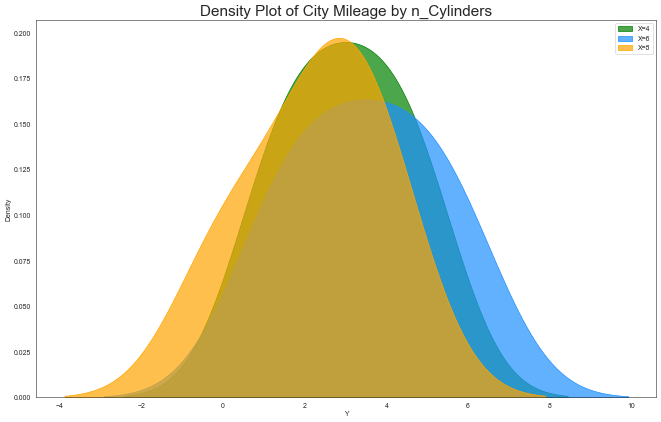

In [45]:
import seaborn as sns
sns.set_style("white")
# Draw a density plot of 'cty' stratified by 'cyl'
plt.figure(figsize=(16,10), dpi= 50)
sns.kdeplot(df.loc[df['X'] == 4, "Y"], shade=True, color="g", label="X=4", alpha=.7)
sns.kdeplot(df.loc[df['X'] == 6, "Y"], shade=True, color="dodgerblue", label="X=6", alpha=.7)
sns.kdeplot(df.loc[df['X'] == 8, "Y"], shade=True, color="orange", label="X=8", alpha=.7)

# Decoration
plt.title('Density Plot of City Mileage by n_Cylinders', fontsize=22)
plt.legend()
plt.show()